This notebook demonstrates that:

# the satpy scene 'dust' composite does not plot correctly using `imshow`

- It ___does___ plot correctly using `scene.show('dust')`
- For the 'natural_color' composite, by comparison, `imshow` ___does___ seem to correctly replicate the image produced by `scene.show('natural_color')` 

### INPUT DATA

The data file used here can be downloaded from: \
https://ladsweb.modaps.eosdis.nasa.gov/archive/allData/61/MYD021KM/2021/237/ \
(filename = MYD021KM.A2021237.1925.061.2021238153422.hdf)

In [1]:
import os
import numpy as np
import glob
from glob import glob

import satpy
from satpy.scene import Scene
from satpy import find_files_and_readers
import pyresample as prs

# Python libraries for visualization
import matplotlib.pyplot as plt
from matplotlib.axes import Axes
import cartopy
import cartopy.crs as ccrs

import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter(action = "ignore", category = RuntimeWarning)
warnings.simplefilter(action = "ignore", category = UserWarning)

Load dust and natural color composites into `scene` object

In [2]:
filename = glob('MYD021KM.A2021237.1925.061.2021238153422.hdf')
scn = Scene(filenames=filename,reader='modis_l1b')
# scn.available_dataset_names()
scn.available_composite_ids()

Too many possible datasets to load for DataQuery(wavelength=0.67)


[DataID(name='airmass'),
 DataID(name='ash'),
 DataID(name='day_essl_colorized_low_level_moisture'),
 DataID(name='day_essl_low_level_moisture'),
 DataID(name='day_microphysics'),
 DataID(name='dust'),
 DataID(name='essl_colorized_low_level_moisture'),
 DataID(name='essl_low_level_moisture'),
 DataID(name='fog'),
 DataID(name='green_snow'),
 DataID(name='ir108_3d'),
 DataID(name='ir_cloud_day'),
 DataID(name='natural_color'),
 DataID(name='natural_color_raw'),
 DataID(name='natural_with_night_fog'),
 DataID(name='night_fog'),
 DataID(name='ocean_color'),
 DataID(name='overview'),
 DataID(name='snow'),
 DataID(name='true_color'),
 DataID(name='true_color_crefl'),
 DataID(name='true_color_thin'),
 DataID(name='true_color_uncorrected')]

In [3]:
scn.load(['natural_color','dust','airmass'], upper_right_corner='NE')

Resample `scn` to north america area
- (this is arbitarily chosen for now, can be refined later)

In [4]:
scn_r = scn.resample('northamerica', radius_of_influence=5000)

Plot the composites using `scene.show` method:

In [5]:
scn_r.show('dust')

In [6]:
scn_r.show('natural_color')

__The above plots both look as expected.__

Now do a refined plot using `imshow` in order to add geographic features & other details later.

In [7]:
#get crs for axes object
crs = scn_r['dust'].attrs['area'].to_cartopy_crs() 

In [8]:
#get image data
# shape = np.asarray(scn_r['natural_color']).shape
# shape
image = np.asarray(scn_r['dust']).transpose(1,2,0) #necessary for imshow

#scale image data to remove outliers that affect contrast
image = np.interp(image, (np.nanpercentile(image,1), np.nanpercentile(image,99)), (0, 1)) 

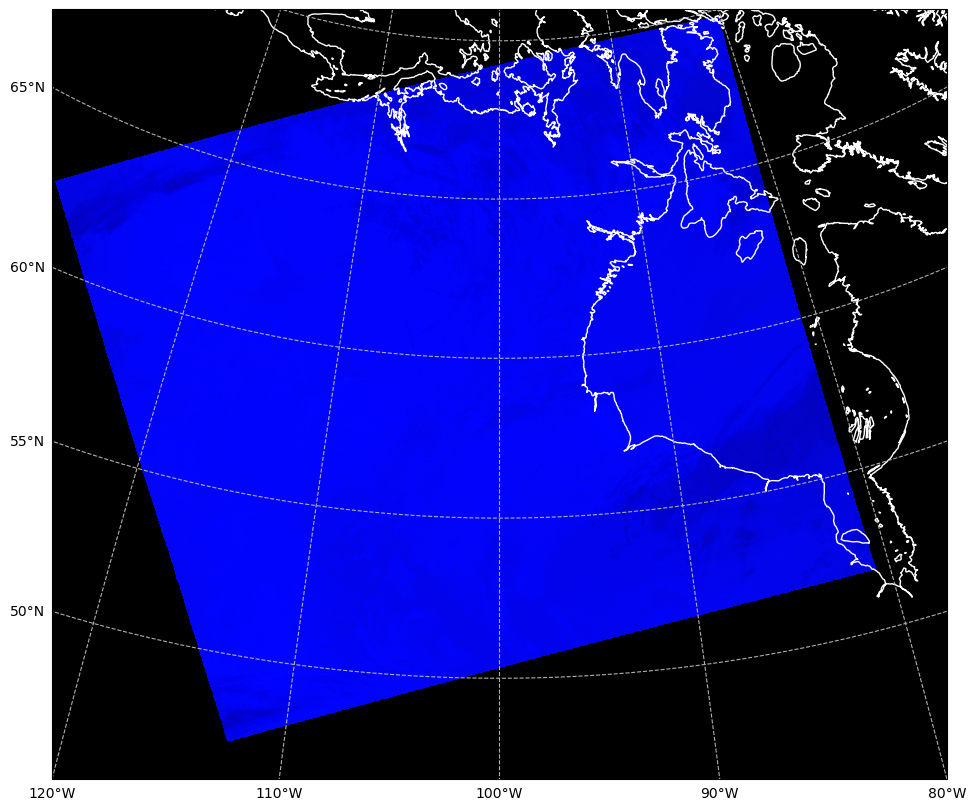

In [9]:
# Initiate a matplotlib figure, add geographic axes
fig = plt.figure(figsize=(16, 10))
ax = fig.add_subplot(1, 1, 1, projection=crs)

# Set up map features
ax.coastlines(resolution="10m", color="white")
ax.set_extent([-120, -80, 45, 70]) 
gl = ax.gridlines(draw_labels=True, linestyle='--', xlocs=range(-120,-70,10), ylocs=range(50,75,5))
gl.top_labels=False
gl.right_labels=False
gl.label_style={'sizeb':14}

# Plot
ax.imshow(image, transform=crs, extent=crs.bounds, origin="upper")
plt.show()

___That doesn't look right.___

Removing the step where the image data were scaled (using `nanpercentile`) doesn't solve the problem either (although the resulting plot does look different):

In [14]:
###COMMENTED OUT TO REDUCE NOTEBOOK SIZE FOR UPLOAD TO GITHUB!!

# image = np.asarray(scn_r['dust']).transpose(1,2,0) #necessary for imshow

# fig = plt.figure(figsize=(16, 10))
# ax = fig.add_subplot(1, 1, 1, projection=crs)

# ax.coastlines(resolution="10m", color="white")
# ax.set_extent([-120, -80, 45, 70]) 
# gl = ax.gridlines(draw_labels=True, linestyle='--', xlocs=range(-120,-70,10), ylocs=range(50,75,5))
# gl.top_labels=False
# gl.right_labels=False
# gl.label_style={'sizeb':14}

# ax.imshow(image, transform=crs, extent=crs.bounds, origin="upper")
# plt.show()

**HOWEVER:**

Repeating the above steps but substituting in the 'natural_color' composite results in a plot that looks correct, when compared to the corresponding output using the `scene.show('natural_color')` method:

In [11]:
#get image data & scale to remove outliers
image = np.asarray(scn_r['natural_color']).transpose(1,2,0) #necessary for imshow
image = np.interp(image, (np.nanpercentile(image,1), np.nanpercentile(image,99)), (0, 1)) 

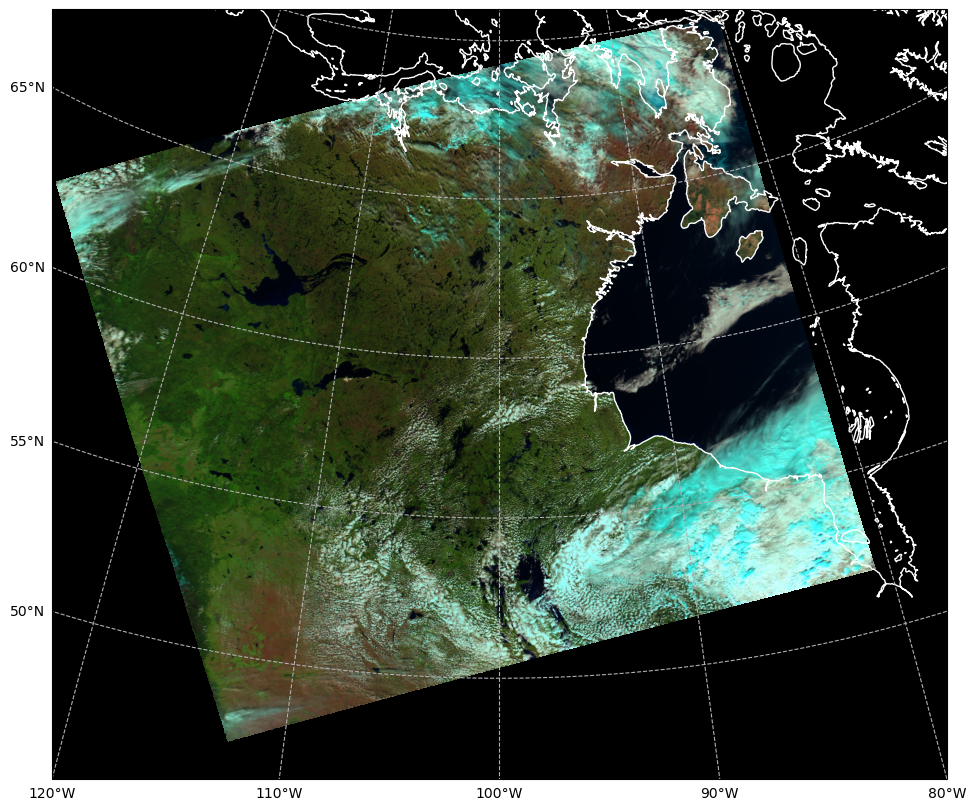

In [12]:
# Plot
fig = plt.figure(figsize=(16, 10))
ax = fig.add_subplot(1, 1, 1, projection=crs)

ax.coastlines(resolution="10m", color="white")
ax.set_extent([-120, -80, 45, 70]) 
gl = ax.gridlines(draw_labels=True, linestyle='--', xlocs=range(-120,-70,10), ylocs=range(50,75,5))
gl.top_labels=False
gl.right_labels=False
gl.label_style={'sizeb':14}

ax.imshow(image, transform=crs, extent=crs.bounds, origin="upper")
plt.show()

### _WHAT IS GOING ON?!_

How can I get the __dust__ composite to plot correctly using the `imshow` method?


__Possible cause:__ \
I do notice that the RGB values in the dust and natural color composites are quite different (printed below) and wonder whether this is affecting how the image is presenting in `imshow`? \
e.g. is there an extra level of processing going on in the background for `scene.show('dust')` compared to `scene.show('natural_color')`, which makes it display correctly using that method? And this additional processing is therefore being missed when the image values are grabbed using `image = np.asarray(scene['dust'])`?
- in the dust composite, the R and G values correspond to the _differences_ between two wavelengths, vs the B values just being from a single wavelength. I am not sure exactly what the RGB values correspond to for the natural color composite. 

In [13]:
image_dust = np.asarray(scn_r['dust']).transpose(1,2,0)
image_natcol = np.asarray(scn_r['natural_color']).transpose(1,2,0)

print('----values in dust RGB-------')
print(np.nanmean(image_dust[:,:,0]),np.nanmin(image_dust[:,:,0]),np.nanmax(image_dust[:,:,0]))
print(np.nanmean(image_dust[:,:,1]),np.nanmin(image_dust[:,:,1]),np.nanmax(image_dust[:,:,1]))
print(np.nanmean(image_dust[:,:,2]),np.nanmin(image_dust[:,:,2]),np.nanmax(image_dust[:,:,2]))

print('-----values in natural color RGB------')
print(np.nanmean(image_natcol[:,:,0]),np.nanmin(image_natcol[:,:,0]),np.nanmax(image_natcol[:,:,0]))
print(np.nanmean(image_natcol[:,:,1]),np.nanmin(image_natcol[:,:,1]),np.nanmax(image_natcol[:,:,1]))
print(np.nanmean(image_natcol[:,:,2]),np.nanmin(image_natcol[:,:,2]),np.nanmax(image_natcol[:,:,2]))

----values in dust RGB-------
-0.9212072521788929 -9.44093035614685 1.7172740475393766
1.2249408707789333 -11.312831184028852 11.297556698977019
278.8105730167776 219.45748287008487 306.0499882924558
-----values in natural color RGB------
21.690786 0.0860678 80.59967
29.82172 1.0633873 141.6856
21.467722 2.5934024 141.6856


**ADDITIONAL NOTES**

1. I have reproduced this problem with the _'airmass'_ composite, and I note that this composite also involves differences betweeb wavelength pairings resulting in image values passed to `imshow` that are more similar to the dust composite than the natural color composite. 

2. This problem isn't exclusive to modis l1b files; i have reproduced this behavious using SEVIRI files, using the data that are made available with the tutorial here: https://www.kaggle.com/code/martinraspaud/satpy-half-day-tutorial-with-msg-data#5.-RGBs-and-Other-Composites) 

3. I am still learning about satpy! The code in this notebook is based on the following tutorials and examples:
    - https://www.kaggle.com/code/martinraspaud/satpy-half-day-tutorial-with-msg-data#5.-RGBs-and-Other-Composites
    - https://python-kurs.github.io/sommersemester_2019/units/S01E06.html\
    - https://fire.trainhub.eumetsat.int/docs/figure1_MODIS_L1B.html 